# Data Exploration

In [ ]:
# Data - https://www.kaggle.com/datasets/danielgrijalvas/movies

In [2]:
# Importing the libraries

import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (10,8)

pd.options.mode.chained_assignment = None

In [3]:
# Reading in the data

df = pd.read_csv(r"/Users/shrutidua/Downloads/movies.csv")

In [4]:
# Looking at the data

pd.set_option('display.max_rows', None)

df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,4.699877e+07,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,5.885311e+07,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,5.383751e+08,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,8.345354e+07,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,3.984634e+07,Orion Pictures,98.0
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000.0,3.975460e+07,Paramount Pictures,95.0
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000.0,1.152299e+08,Universal Pictures,133.0
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000.0,2.340243e+07,Chartoff-Winkler Productions,129.0
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000.0,1.081857e+08,Dovemead Films,127.0
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000.0,1.579519e+07,United Artists,100.0


In [ ]:
# Cleaning the data

In [5]:
# Looking for missing data
    
df.isnull().sum() 

name           0
rating        77
genre          0
year           0
released       2
score          3
votes          3
director       0
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64

In [6]:
# Dropping rows that have missing data and resetting the index

df = df.dropna()
df.reset_index(drop=True, inplace=True)

In [7]:
# Checking the missing values again

df.isnull().sum()

name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64

In [8]:
# Looking at column data types

df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [9]:
# Adjusting the column data types

df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')
df['votes'] = df['votes'].astype('int64')
df['runtime'] = df['runtime'].astype('int64')

In [10]:
# Making sure the year in the released column and the year column match

df['correct_year'] = df['released'].str.extract(pat = '([0-9]{4})').astype(str)

df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,correct_year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95,1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133,1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129,1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127,1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100,1980


In [11]:
# Arranging the data according to gross revenue

df.sort_values(by=['gross'], inplace = False, ascending = False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,correct_year
3731,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,2009
5302,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,2019
1795,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,1997
4730,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,2015
5158,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,2018
5334,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118,2019
4720,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124,2015
4224,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143,2012
4713,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137,2015
5346,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103,2019


In [ ]:
# Data exploration

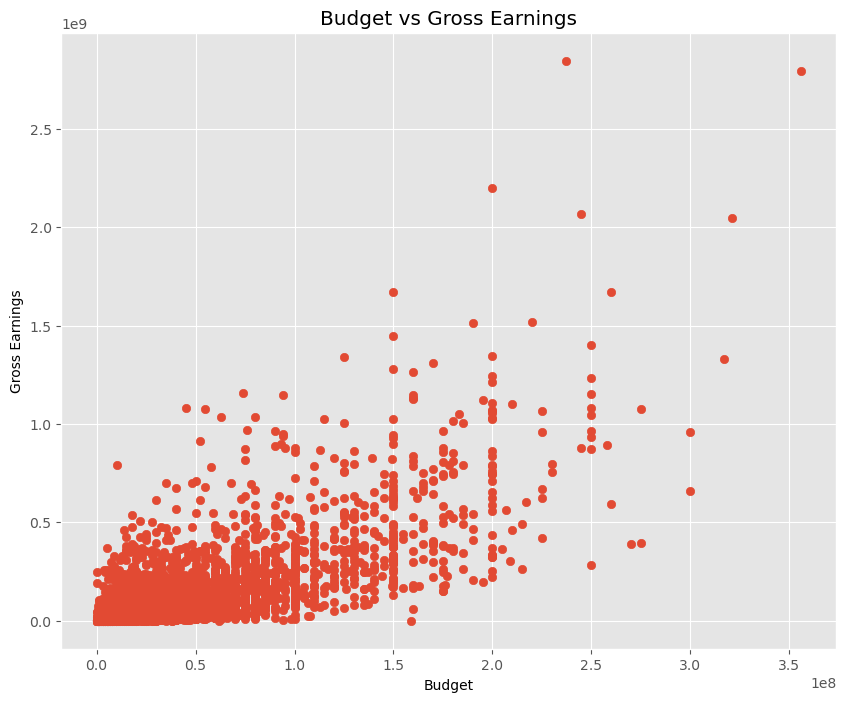

In [12]:
# Looking at the relation between the budget and gross revenue of the money using a scatter plot

plt.scatter(x = df['budget'], y = df['gross'])
plt.title('Budget vs Gross Earnings')
plt.xlabel('Budget')
plt.ylabel('Gross Earnings')
plt.show()

<Axes: xlabel='budget', ylabel='gross'>

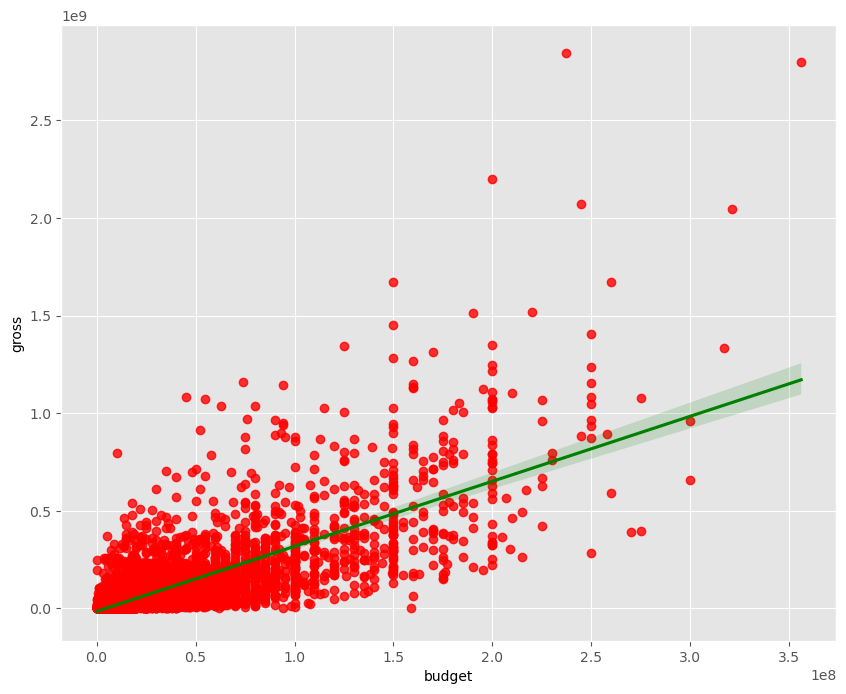

In [13]:
# Plotting a regression plot for budget vs gross revenue to understand the relation better

sns.regplot(x = "budget", y = "gross", data = df, scatter_kws = {'color' : 'red'}, line_kws = {'color' : 'green'})

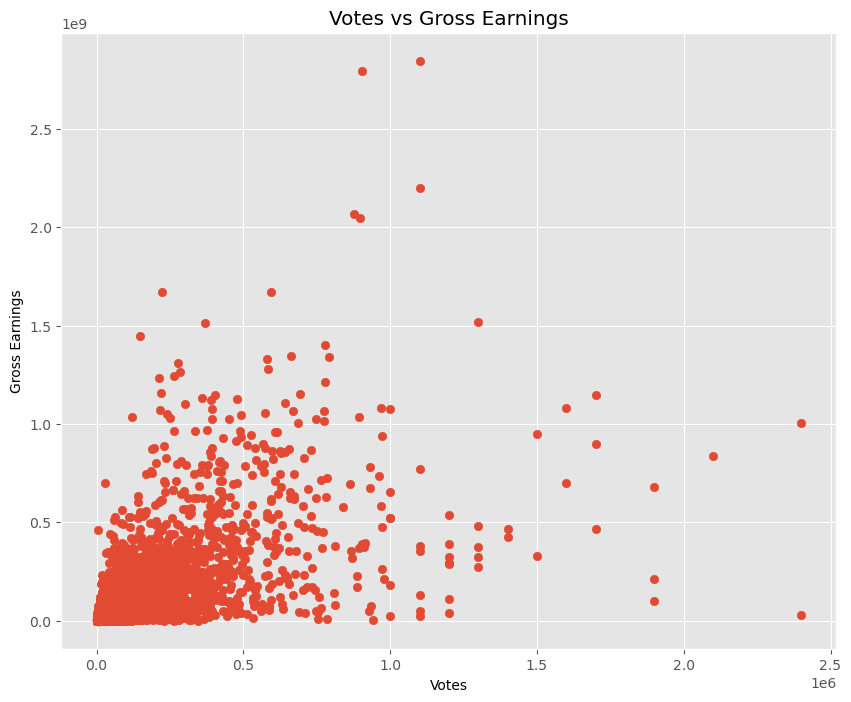

In [14]:
# Similarly plotting the scatter plot and regression plot for votes vs gross revenue

plt.scatter(x = df['votes'], y = df['gross'])
plt.title('Votes vs Gross Earnings')
plt.xlabel('Votes')
plt.ylabel('Gross Earnings')
plt.show()

<Axes: xlabel='votes', ylabel='gross'>

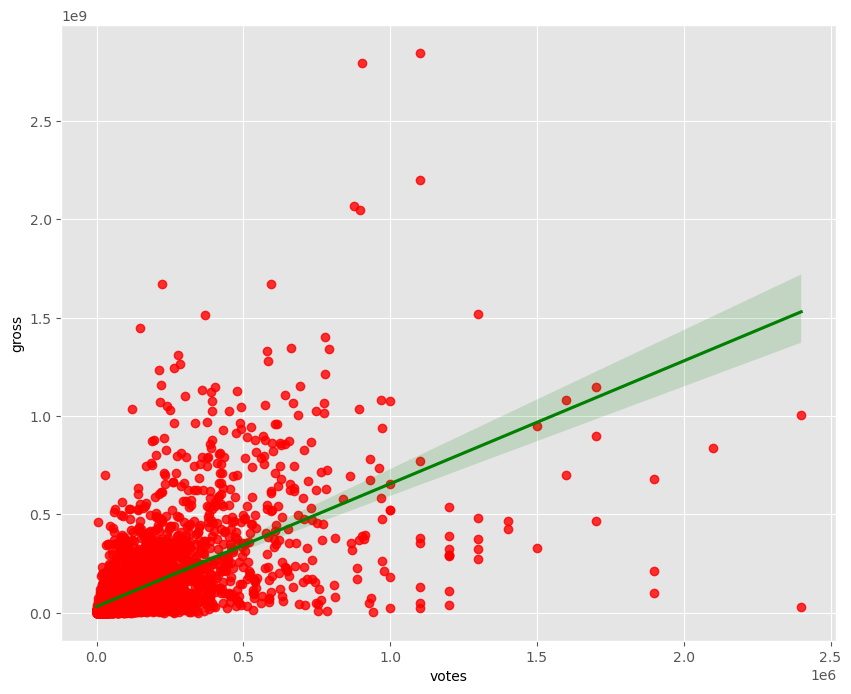

In [15]:
# Regression plot between votes and gross revenue

sns.regplot(x = "votes", y = "gross", data = df, scatter_kws = {'color' : 'red'}, line_kws = {'color' : 'green'})

In [16]:
# Now, let's look at the Correlation Matrix between all numeric columns. We are using the Pearson method.

df.corr(method ='pearson', numeric_only = True)

# From the resulting matrix, we can see that budget and gross have the highest positive correlation coefficient of 0.740247
# followed by correlation between votes and gross revenue which is 0.614751

# Hence, we can see that there is a strong positive correlation between budget and gross revenue as well as votes and gross revenue

,year,score,votes,budget,gross,runtime
year,1.000000,0.056386,0.206021,0.327722,0.274321,0.075077
score,0.056386,1.000000,0.474256,0.072001,0.222556,0.414068
votes,0.206021,0.474256,1.000000,0.439675,0.614751,0.352303
budget,0.327722,0.072001,0.439675,1.000000,0.740247,0.318695
gross,0.274321,0.222556,0.614751,0.740247,1.000000,0.275796
runtime,0.075077,0.414068,0.352303,0.318695,0.275796,1.000000


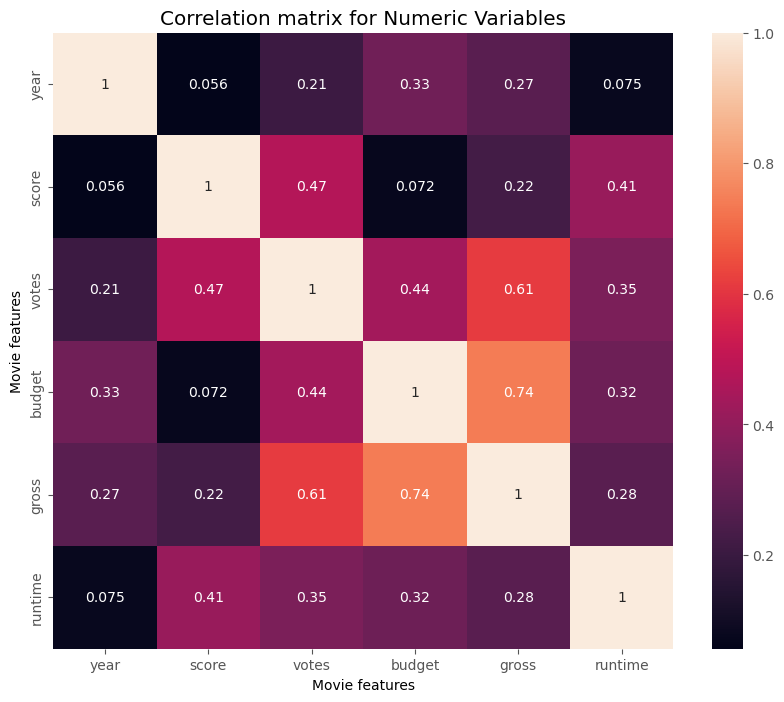

In [17]:
# Visualizing the correlation matrix

correlation_matrix = df.corr(method ='pearson', numeric_only = True)

sns.heatmap(correlation_matrix, annot = True)

plt.title("Correlation matrix for Numeric Variables")

plt.xlabel("Movie features")

plt.ylabel("Movie features")

plt.show()

In [18]:
# Looking at the Correlation pairs arranged in decreasing coefficient values

corr_pairs = correlation_matrix.unstack()

corr_sorted_pairs = corr_pairs.sort_values(ascending=False, kind="quicksort")

print(corr_sorted_pairs)

year     year       1.000000
score    score      1.000000
gross    gross      1.000000
budget   budget     1.000000
votes    votes      1.000000
runtime  runtime    1.000000
gross    budget     0.740247
budget   gross      0.740247
gross    votes      0.614751
votes    gross      0.614751
score    votes      0.474256
votes    score      0.474256
budget   votes      0.439675
votes    budget     0.439675
runtime  score      0.414068
score    runtime    0.414068
runtime  votes      0.352303
votes    runtime    0.352303
year     budget     0.327722
budget   year       0.327722
         runtime    0.318695
runtime  budget     0.318695
gross    runtime    0.275796
runtime  gross      0.275796
gross    year       0.274321
year     gross      0.274321
gross    score      0.222556
score    gross      0.222556
votes    year       0.206021
year     votes      0.206021
         runtime    0.075077
runtime  year       0.075077
budget   score      0.072001
score    budget     0.072001
year     score

In [19]:
# Going a step further, we are now going to look at pairs with strong positive correlation
# i.e correlation coefficient > 0.5

strong_pairs = corr_sorted_pairs[corr_sorted_pairs > 0.5]

print(strong_pairs)

year     year       1.000000
score    score      1.000000
gross    gross      1.000000
budget   budget     1.000000
votes    votes      1.000000
runtime  runtime    1.000000
gross    budget     0.740247
budget   gross      0.740247
gross    votes      0.614751
votes    gross      0.614751
dtype: float64


In [21]:
# Average Gross Earnings earned by each genre

df.groupby('genre')['gross'].mean().sort_values(ascending=False)

genre
Family       5.185831e+08
Animation    2.811044e+08
Action       1.680232e+08
Adventure    1.332682e+08
Mystery      1.178877e+08
Biography    6.139527e+07
Drama        6.036914e+07
Comedy       5.916766e+07
Horror       5.681695e+07
Crime        5.016958e+07
Thriller     4.248814e+07
Fantasy      3.987870e+07
Sci-Fi       3.761010e+07
Romance      3.357538e+07
Western      1.001294e+07
Name: gross, dtype: float64

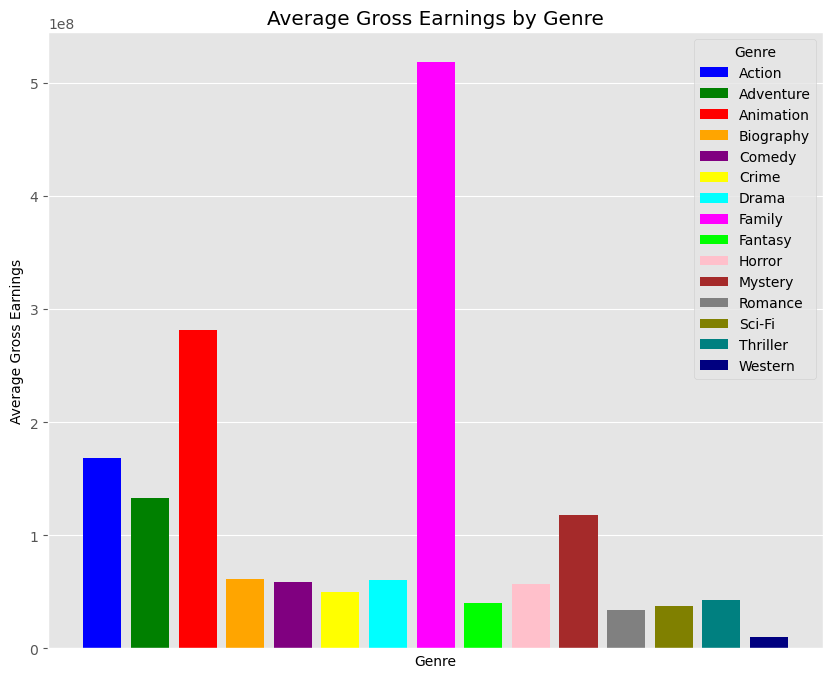

In [33]:
# Visualising the Average Gross Earnings earned by each genre

average_gross_genre = df.groupby('genre')['gross'].mean()

colors = ['blue', 'green', 'red', 'orange', 'purple', 'yellow', 'cyan', 'magenta', 'lime', 'pink', 'brown', 'gray', 'olive', 'teal', 'navy']

chart = plt.bar(average_gross_genre.index, average_gross_genre.values, color = colors)

plt.xlabel('Genre')
plt.ylabel('Average Gross Earnings')
plt.title('Average Gross Earnings by Genre')
plt.xticks([])

plt.legend(chart, average_gross_genre.index, title='Genre')

plt.show()


In [23]:
# Top 10 years with highest Average Gross Earnings 

df.groupby('correct_year')['gross'].mean().sort_values(ascending=False).head(10)

correct_year
2020    2.592008e+08
2019    2.267999e+08
2017    1.969212e+08
2018    1.945072e+08
2016    1.711169e+08
2015    1.675178e+08
2012    1.608359e+08
2013    1.594188e+08
2014    1.543654e+08
2009    1.416777e+08
Name: gross, dtype: float64

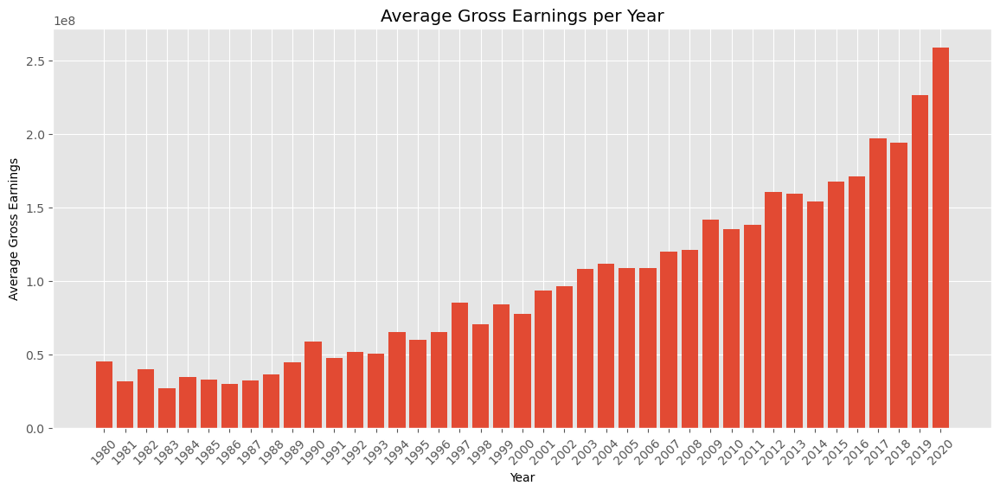

In [54]:
# Visualising the Average Gross Earnings earned per year from 1980 to 2020

plt.figure(figsize=(14, 6))

average_gross_year = df.groupby('correct_year')['gross'].mean()

#colors = ['blue', 'green', 'red', 'orange', 'purple', 'yellow', 'cyan', 'magenta', 'lime', 'pink', 'brown', 'gray', 'olive', 'teal', 'navy']

chart = plt.bar(average_gross_year.index, average_gross_year.values)

plt.xlabel('Year')
plt.ylabel('Average Gross Earnings')
plt.title('Average Gross Earnings per Year')
plt.xticks(rotation=45)

plt.show()